 # Optimizing the lenght of the window for the VGPs based APWP

In [1]:
import os
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
from pmagpy import ipmag, pmag
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("white")
from vgptools.auxiliar import (get_files_in_directory, spherical2cartesian, 
                               cartesian2spherical, GCD_cartesian, shape, get_angle, PD)                              
from vgptools.utils_compilation import dfs_vgps_recomputed_poles
from vgptools.utils_APWPs import running_mean_APWP_shape, RM_stats, running_mean_bootstrapping_direction
from vgptools.utils_visualization import  RM_stats, plot_VGPs_and_APWP, plot_APWP_RM_ensemble, quantiles,plot_pole_A95, plot_pole, PC
np.random.seed(10)

## 1. Compile the VGPs 

In [2]:
current_path = os.getcwd()
data_path_VGP = current_path + '/data/vgp_database'

In [3]:
# df_filtered_vgps, df_pole_compilation = dfs_vgps_recomputed_poles(data_path_VGP, by_study = True) # takes as many as poles as are described for one are
df_filtered_vgps = pd.read_csv(current_path +'/data/df_vgps_filtered.csv')

### 2. Running means changing both, window lenght and step size 
In this experiment, and for a given realization $r$ (with a given window $W_r$ and step size $S_r$) we proceed with the following steps:
1. Generate a bootstrap sample $X_b$ from the compiled dataset of VGPs $X$ ($N=989$).  
2. For each entry $i$ in the bootstrapped sample $X_b$, take a direction $\hat \mu_i$ at random from $\text{Fisher}(\mu_i, \kappa_i)$ and an age $\hat t$ from $N(t_i, \sigma_i)$ or $U(t_{max}, t_{max})$. Calculate a $VGP_i$ for each $i$. This approach allows us to fully propagate the directional uncertainty (fisher distributed due to white random noise) towards the VGP/Pole space.
3. Calculate a Running Mean with parameters $W_r$ and $S_r$ on the bootstrapped sample $X_b$ and store the mean positions $\mu M_b$. For each window calculate the following parameters that will help us to assess the shape of the point-cloud: the dispersion parameter $S$, the concentration parameter $\kappa$, the foliation, the lineation, the coplanarity, the collinearity, the angular rate of motion from the last mean, and finally, the angle formed between the previous mean pole and the following (proportional to the 'smothness of the whole path').

By repeating this process $B*R$ times, we end-up, for a given window $W_r$ and step size $S_r$, with 100 $\mu M_b$ 100 mean positions for each given age.

In [23]:
%%time

min_age = 0
max_age = 65
steps = [2,5] #[2,5,10] 
window_lengths = np.arange(5,30,2)

df_ensemble = pd.DataFrame()

for step in steps:
    for window in window_lengths:    
        for i in range(100):
            sample = df_filtered_vgps.sample(n = len(df_filtered_vgps), replace = True)
            df_RM = running_mean_APWP_shape(sample, 'vgp_lon_SH', 'vgp_lat_SH', 'mean_age', window, step, max_age, min_age)
            df_RM['run'] = i
            df_RM['window'] = window
            df_RM['time_step'] = step
            df_ensemble = df_ensemble.append(df_RM, ignore_index=True)

CPU times: user 9min 36s, sys: 2.67 s, total: 9min 39s
Wall time: 9min 39s


In [24]:
df = df_ensemble.copy()
df=df[(df['age']>10)&(df['age']<60)]

In [26]:
df.columns

Index(['age', 'N', 'n_studies', 'k', 'A95', 'csd', 'plon', 'plat', 'foliation',
       'lineation', 'collinearity', 'coplanarity', 'GCD', 'APW_rate', 'angle',
       'run', 'window', 'time_step'],
      dtype='object')

### 

<AxesSubplot:xlabel='window', ylabel='APW_rate'>

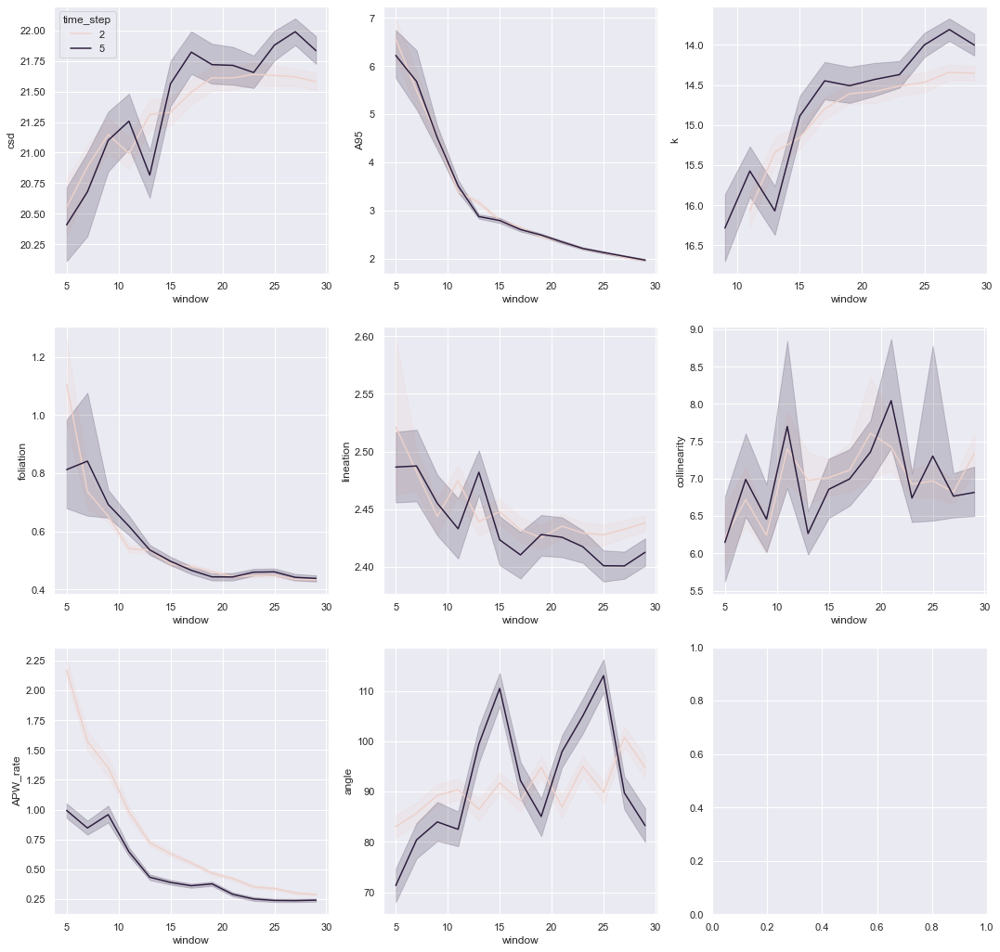

In [28]:
sns.set_theme(style="darkgrid")
fig, axes = plt.subplots(3, 3, figsize=(18, 18))
sns.lineplot(x="window", y="csd", hue="time_step", data=df, ax = axes[0,0], legend = True)
sns.lineplot(x="window", y="A95", hue="time_step", data=df, ax = axes[0,1], legend = False)
sns.lineplot(x="window", y="k", hue="time_step", data=df, ax = axes[0,2], legend = False)
sns.lineplot(x="window", y="foliation", hue="time_step", data=df, ax = axes[1,0], legend = False)
sns.lineplot(x="window", y="lineation", hue="time_step", data=df, ax = axes[1,1], legend = False)
sns.lineplot(x="window", y="collinearity", hue="time_step", data=df, ax = axes[1,2], legend = False)
sns.lineplot(x="window", y="angle", hue="time_step", data=df, ax = axes[2,1], legend = False)
sns.lineplot(x="window", y="APW_rate", hue="time_step", data=df, ax = axes[2,0], legend = False)


In [29]:
%%time
array = np.empty((0,12), np.float64)

for window, df_window in df.groupby('window'):
    for time_step, df_step in df_window.groupby('time_step'):
        for age, df_age in df_step.groupby('age'):
            
            ArrayXYZ = np.array([spherical2cartesian([np.radians(i['plon']), np.radians(i['plat'])]) for _,i in df_age.iterrows()])            
            shapes = shape(ArrayXYZ)
            PrinComp=PD(ArrayXYZ)
            
            mean = ipmag.fisher_mean(dec=df_age['plon'].tolist(), inc=df_age['plat'].tolist())
            
            PC_lat = np.degrees(cartesian2spherical(PrinComp))[1]#mean['inc'] #
            PC_lon = np.degrees(cartesian2spherical(PrinComp))[0]#mean['dec'] #
            
            newrow = [window, time_step, mean['n'], age, PC_lat, PC_lon, shapes[0], shapes[1], shapes[2], shapes[3], mean['csd'], mean['k']]
            
            array = np.vstack([array, newrow])
            
pole_mean_shapes = pd.DataFrame(array, columns = ['window', 'time_step', 'n', 'age', 'plat_PC', 'plon_PC', 'foliation', 
                                                  'lineation', 'collinearity', 'coplanarity', 'csd', 'kappa'])

CPU times: user 1.54 s, sys: 12.2 ms, total: 1.55 s
Wall time: 1.55 s


In [34]:
x = pole_mean_shapes[(pole_mean_shapes['time_step'] ==2)].copy()
# x = pole_mean_shapes.copy()
x.head()

,window,time_step,n,age,plat_PC,plon_PC,foliation,lineation,collinearity,coplanarity,csd,kappa
0,5.0,2.0,97.0,12.0,99.313232,-53.806829,3.920970,0.492555,0.125621,4.413525,12.535143,41.755284
1,5.0,2.0,60.0,14.0,-70.150429,-41.105661,2.532278,2.129866,0.841087,4.662144,10.247396,62.480279
2,5.0,2.0,64.0,16.0,-81.488693,35.601714,3.443355,3.584221,1.040909,7.027576,3.833920,446.358620
3,5.0,2.0,100.0,18.0,-76.632518,4.048398,3.095735,2.649825,0.855960,5.745560,5.057147,256.542226
4,5.0,2.0,100.0,20.0,-81.444150,-6.700793,3.350065,3.153605,0.941356,6.503669,2.844292,811.001389


Text(0, 0.5, 'Latitude (°N)')

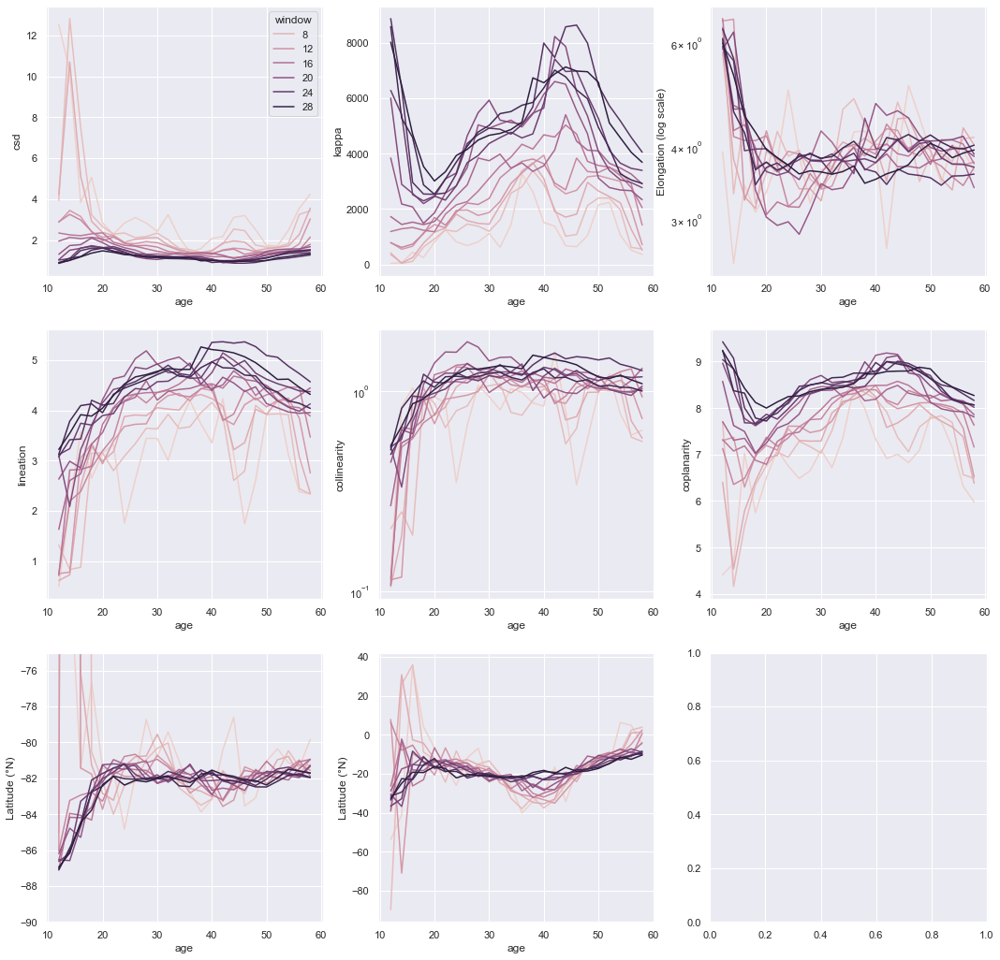

In [35]:
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

sns.lineplot(x="age", y="csd", hue="window", data=x, ax = axes[0,0], legend = True)
# axes[0,0].set_yscale('log')
sns.lineplot(x="age", y="kappa", hue="window", data=x, ax = axes[0,1], legend = False)
sns.lineplot(x="age", y="foliation", hue="window", data=x, ax = axes[0,2], legend = False)
axes[0,2].set_ylabel('Elongation (log scale)')
axes[0,2].set_yscale('log')
sns.lineplot(x="age", y="lineation", hue="window", data=x, ax = axes[1,0], legend = False)
sns.lineplot(x="age", y="collinearity", hue="window", data=x, ax = axes[1,1], legend = False)
axes[1,1].set_yscale('log')
sns.lineplot(x="age", y="coplanarity", hue="window", data=x, ax = axes[1,2], legend = False)
sns.lineplot(x="age", y="plat_PC", hue="window", data=x, ax = axes[2,0], legend = False)
axes[2,0].set_ylabel('Longitude (°E)')
axes[2,0].set_ylabel('Latitude (°N)')
axes[2,0].set_ylim(-90,-75)
sns.lineplot(x="age", y="plon_PC", hue="window", data=x, ax = axes[2,1], legend = False)
axes[2,1].set_ylabel('Longitude (°E)')
axes[2,1].set_ylabel('Latitude (°N)')

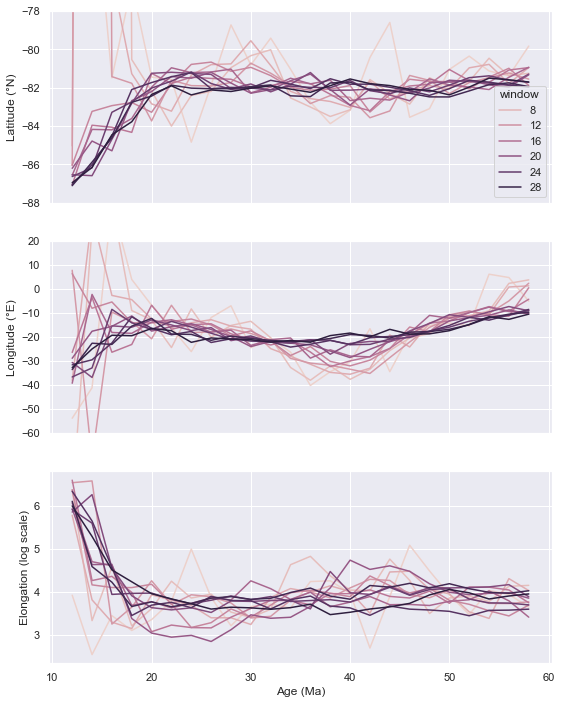

In [54]:
fig, axes = plt.subplots(3, 1, figsize=(9, 12), sharex=True)

sns.lineplot(x="age", y="foliation", hue="window", data=x, ax = axes[2], legend = False)
axes[2].set_ylabel('Elongation (log scale)', fontsize = 12)
axes[2].set_xlabel('Age (Ma)',  fontsize = 12)

sns.lineplot(x="age", y="plat_PC", hue="window", data=x, ax = axes[0], legend = True)
axes[0].set_ylabel('Latitude (°N)', fontsize = 12)
axes[0].set_xlabel('Age (Ma)',  fontsize = 12)
axes[0].set_ylim(-88,-78)

sns.lineplot(x="age", y="plon_PC", hue="window", data=x, ax = axes[1], legend = False)
axes[1].set_ylabel('Longitude (°E)',  fontsize = 12)
axes[1].set_xlabel('Age (Ma)',  fontsize = 12)
axes[1].set_ylim(-60,20)
plt.savefig(current_path + '/figures/5/5a.svg', dpi =600, bbox_inches='tight')

<AxesSubplot:xlabel='age', ylabel='plon_PC'>

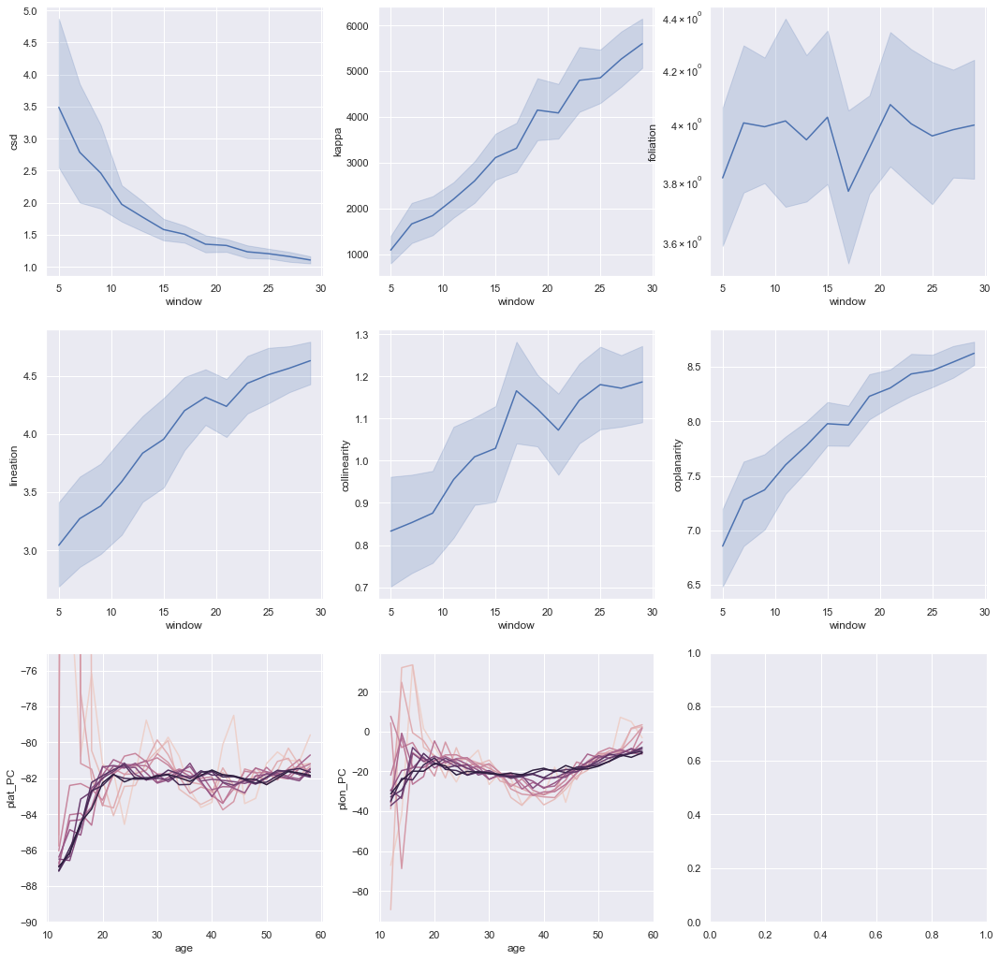

In [18]:
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

sns.lineplot(x="window", y="csd",  data=x, ax = axes[0,0], legend = True)
# axes[0,0].set_yscale('log')
sns.lineplot(x="window", y="kappa", data=x, ax = axes[0,1], legend = False)
sns.lineplot(x="window", y="foliation",  data=x, ax = axes[0,2], legend = False)
axes[0,2].set_yscale('log')
sns.lineplot(x="window", y="lineation",  data=x, ax = axes[1,0], legend = False)
sns.lineplot(x="window", y="collinearity",  data=x, ax = axes[1,1], legend = False)
# axes[1,1].set_yscale('log')
sns.lineplot(x="window", y="coplanarity",  data=x, ax = axes[1,2], legend = False)
sns.lineplot(x="age", y="plat_PC", hue="window", data=x, ax = axes[2,0], legend = False)
axes[2,0].set_ylim(-90,-75)
sns.lineplot(x="age", y="plon_PC", hue="window", data=x, ax = axes[2,1], legend = False)

In [7]:
df.head()

,age,N,n_studies,k,A95,csd,plon,plat,foliation,lineation,collinearity,coplanarity,GCD,APW_rate,angle,run,window,time_step
6,18.0,19.0,1.0,26.253656,6.675198,15.808480,-15.482214,-70.701775,1.546420+0.000000j,2.784026+0.000000j,1.800304+0.000000j,4.330446+0.000000j,13.972743,1.746593,48.061739,0,5,2
7,20.0,35.0,3.0,27.406053,4.715500,15.472546,-4.699138,-76.933025,1.047517+0.000000j,2.908995+0.000000j,2.777038+0.000000j,3.956512+0.000000j,6.892739,3.446369,90.790933,0,5,2
8,22.0,53.0,4.0,32.921327,3.458863,14.117128,-12.096200,-77.801417,0.282816+0.000000j,3.353801+0.000000j,11.858597+0.000000j,3.636617+0.000000j,1.834317,0.917158,118.241539,0,5,2
9,24.0,54.0,4.0,13.613963,5.448506,21.952942,-14.450138,-82.564542,1.171134+0.000000j,2.174705+0.000000j,1.856923+0.000000j,3.345839+0.000000j,4.779020,2.389510,172.709104,0,5,2
10,26.0,93.0,3.0,8.46406,5.364771,27.841694,-14.071619,-84.227446,1.224529+0.000000j,1.636354+0.000000j,1.336313+0.000000j,2.860883+0.000000j,1.663464,0.831732,7.866605,0,5,2


<AxesSubplot:xlabel='window', ylabel='plon_PC'>

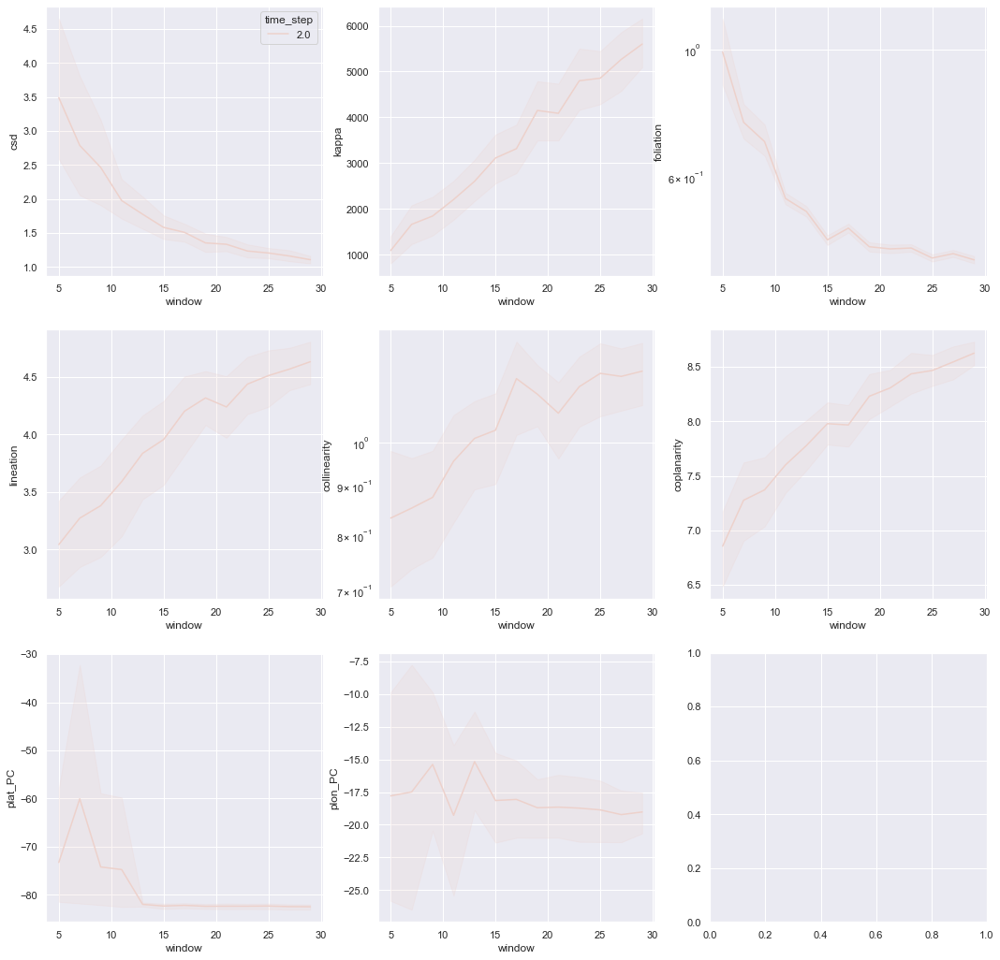

In [16]:
fig, axes = plt.subplots(3, 3, figsize=(18, 18))

sns.lineplot(x="window", y="csd", hue="time_step", data=x, ax = axes[0,0], legend = True)
# axes[0,0].set_yscale('log')
sns.lineplot(x="window", y="kappa", hue="time_step", data=x, ax = axes[0,1], legend = False)
sns.lineplot(x="window", y="foliation", hue="time_step", data=df, ax = axes[0,2], legend = False)
axes[0,2].set_yscale('log')
sns.lineplot(x="window", y="lineation", hue="time_step", data=x, ax = axes[1,0], legend = False)
sns.lineplot(x="window", y="collinearity", hue="time_step", data=x, ax = axes[1,1], legend = False)
axes[1,1].set_yscale('log')
sns.lineplot(x="window", y="coplanarity", hue="time_step", data=x, ax = axes[1,2], legend = False)
sns.lineplot(x="window", y="plat_PC", hue="time_step", data=x, ax = axes[2,0], legend = False)
sns.lineplot(x="window", y="plon_PC", hue="time_step", data=x, ax = axes[2,1], legend = False)

<AxesSubplot:xlabel='window', ylabel='csd'>

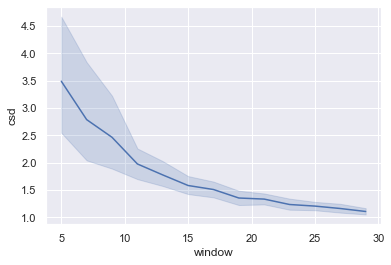

In [12]:
sns.lineplot(x="window", y="csd",  data=x,  legend = True)

(0.0, 0.7)

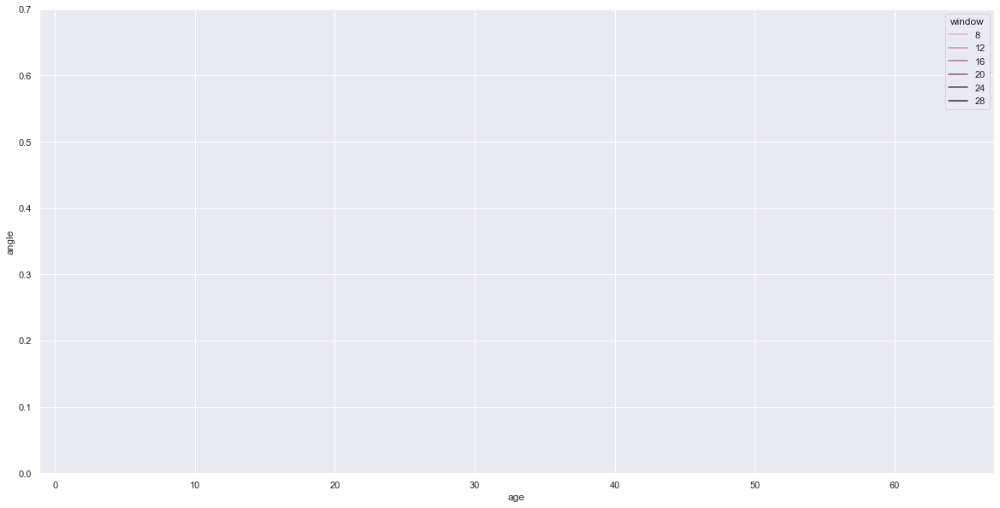

In [45]:
sns.set_theme(style="darkgrid")

fig, ax = plt.subplots(figsize=(20,10))

sns.lineplot(x="age", y="angle",
             hue="window", 
             data=df, ax = ax)
ax.set_ylim(0,0.7)

<AxesSubplot:xlabel='window', ylabel='csd'>

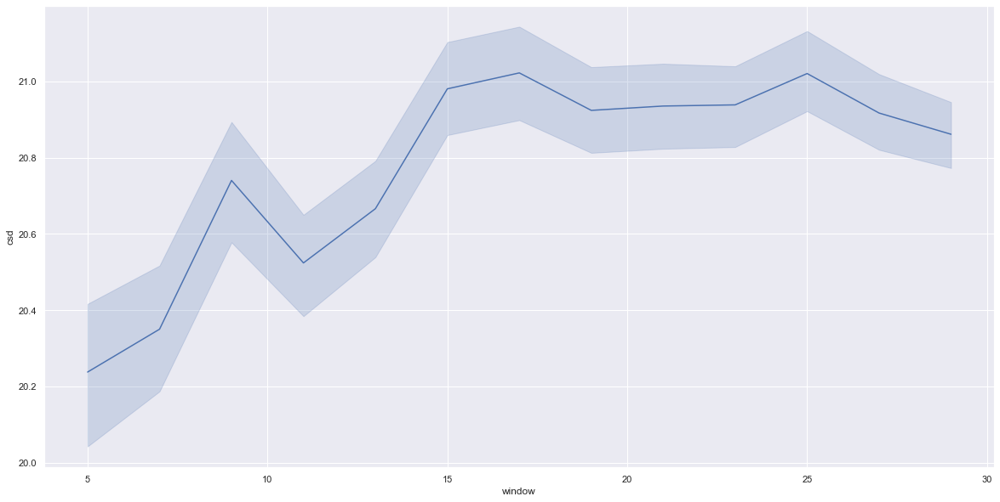

In [18]:
sns.set_theme(style="darkgrid")

fig, ax = plt.subplots(figsize=(20,10))

sns.lineplot(x="window", y="csd",
             # hue="time_step", 
             data=df, ax = ax)

<AxesSubplot:xlabel='window', ylabel='angle'>

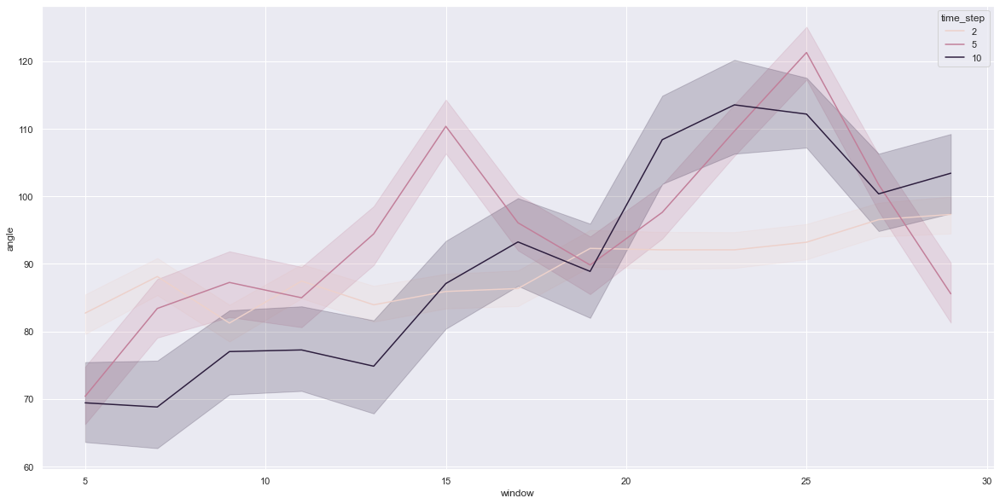

In [8]:
sns.set_theme(style="darkgrid")

fig, ax = plt.subplots(figsize=(20,10))

sns.lineplot(x="window", y="angle",
             hue="time_step", 
             data=df, ax = ax)

In [9]:
variables = df.columns.values.tolist()
variables = ['k','A95','csd','foliation','lineation','collinearity']

<AxesSubplot:xlabel='window', ylabel='angle'>

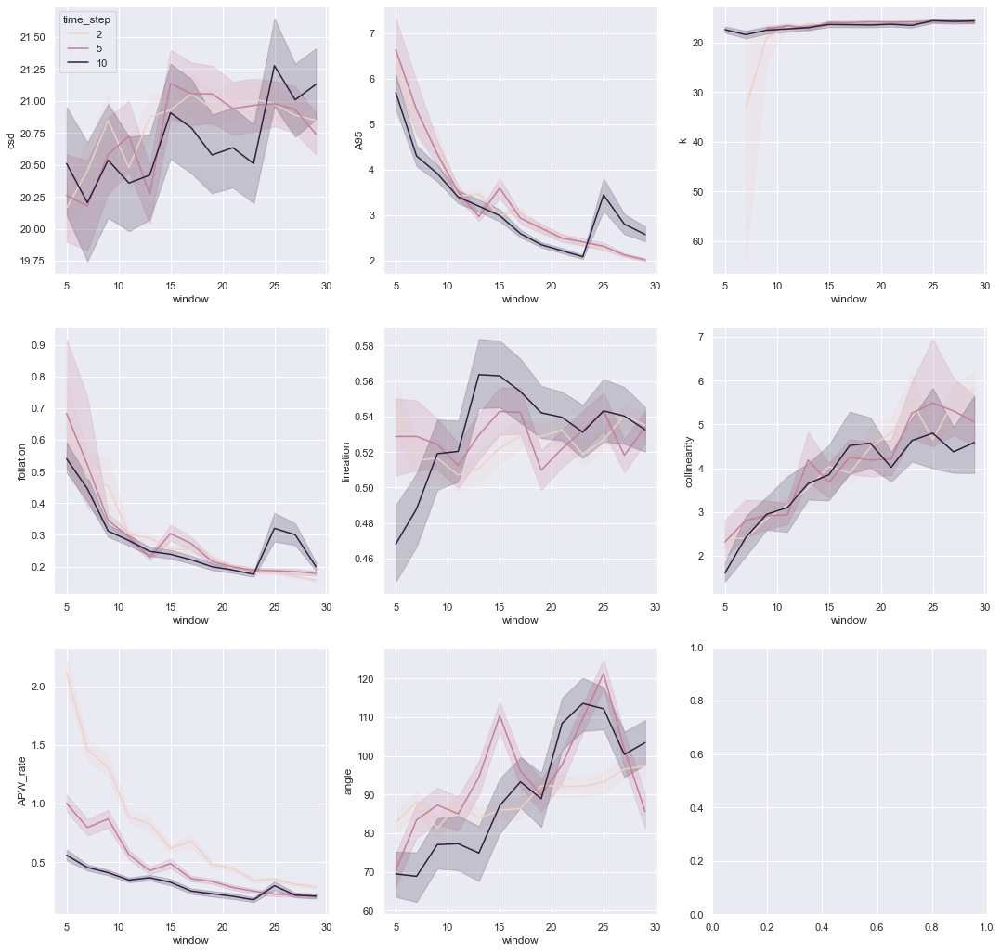

In [11]:
fig, axes = plt.subplots(3, 3, figsize=(18, 18))
sns.lineplot(x="window", y="csd", hue="time_step", data=df, ax = axes[0,0], legend = True)
sns.lineplot(x="window", y="A95", hue="time_step", data=df, ax = axes[0,1], legend = False)
sns.lineplot(x="window", y="k", hue="time_step", data=df, ax = axes[0,2], legend = False)
sns.lineplot(x="window", y="foliation", hue="time_step", data=df, ax = axes[1,0], legend = False)
sns.lineplot(x="window", y="lineation", hue="time_step", data=df, ax = axes[1,1], legend = False)
sns.lineplot(x="window", y="collinearity", hue="time_step", data=df, ax = axes[1,2], legend = False)
sns.lineplot(x="window", y="APW_rate", hue="time_step", data=df, ax = axes[2,0], legend = False)
sns.lineplot(x="window", y="angle", hue="time_step", data=df, ax = axes[2,1], legend = False)

<AxesSubplot:xlabel='age', ylabel='APW_rate'>

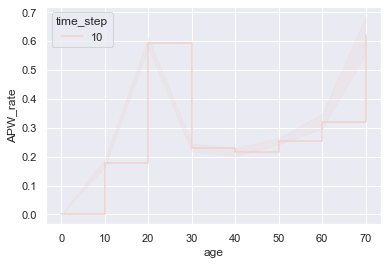

In [25]:
df = df_ensemble
df = df[df['time_step'] == 10]
sns.lineplot(x="age", y="APW_rate", hue="time_step", data=df, drawstyle='steps-post')

Time Step: 2 Ma, Window lenght: 5 Ma.


IllegalArgumentException: Points of LinearRing do not form a closed linestring


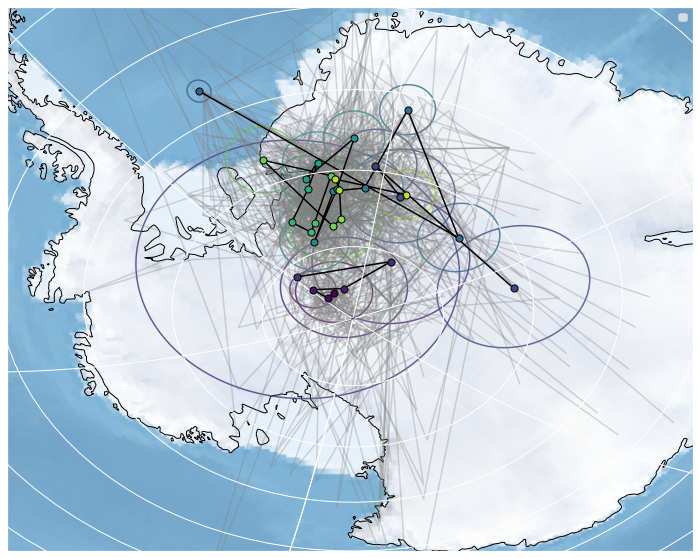

Time Step: 2 Ma, Window lenght: 7 Ma.


IllegalArgumentException: Points of LinearRing do not form a closed linestring
IllegalArgumentException: Points of LinearRing do not form a closed linestring
IllegalArgumentException: Points of LinearRing do not form a closed linestring


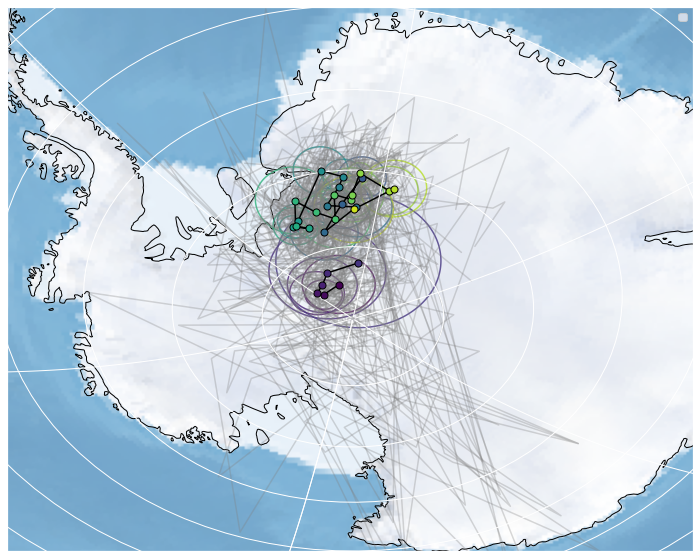

Time Step: 2 Ma, Window lenght: 9 Ma.


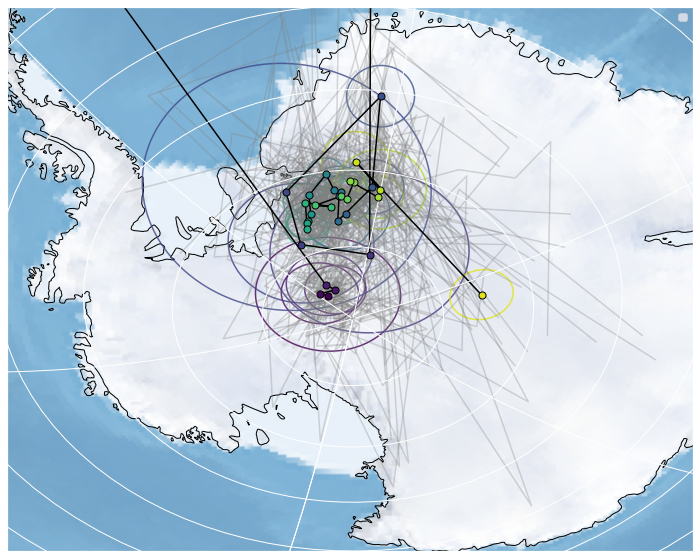

Time Step: 2 Ma, Window lenght: 11 Ma.


IllegalArgumentException: Points of LinearRing do not form a closed linestring


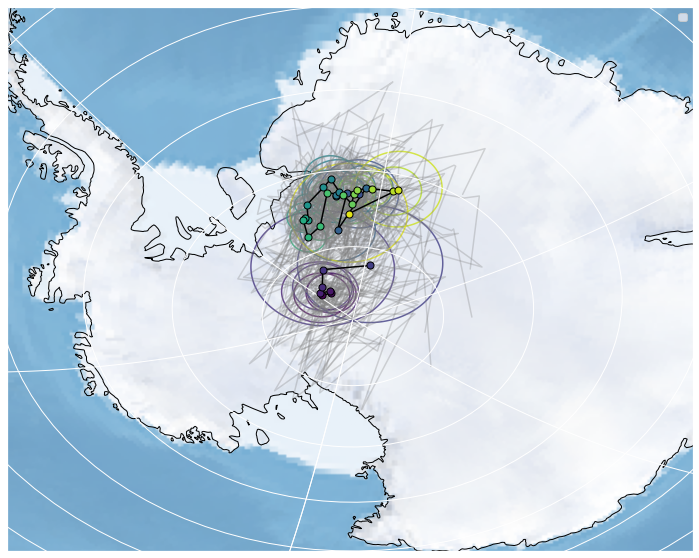

Time Step: 2 Ma, Window lenght: 13 Ma.


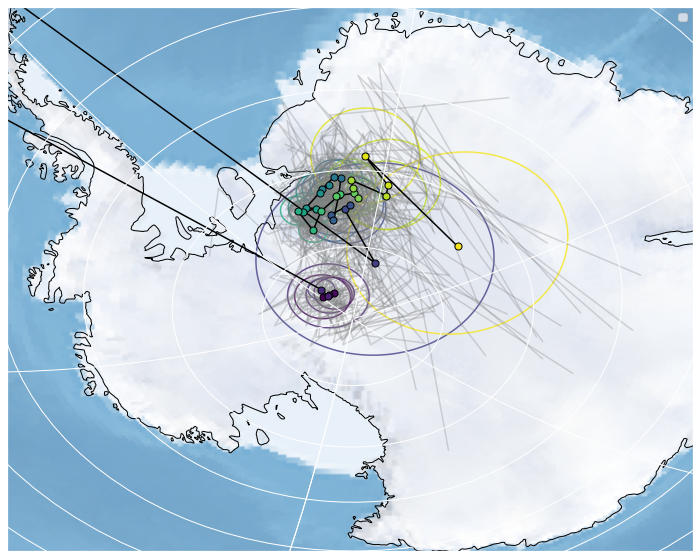

Time Step: 2 Ma, Window lenght: 15 Ma.


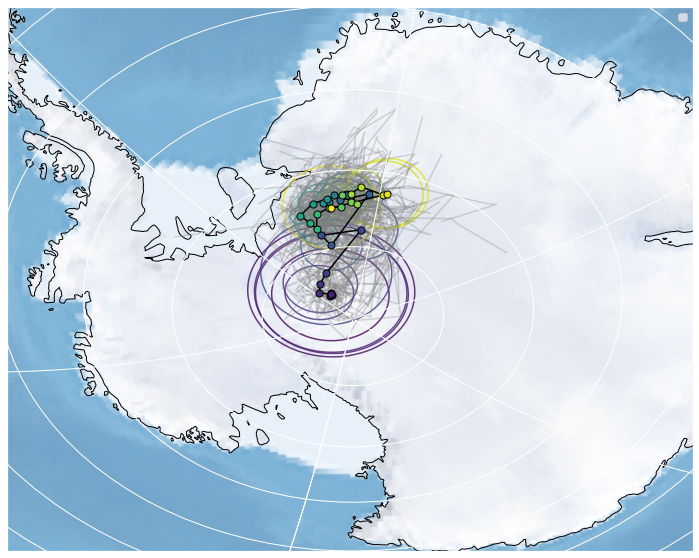

Time Step: 2 Ma, Window lenght: 17 Ma.


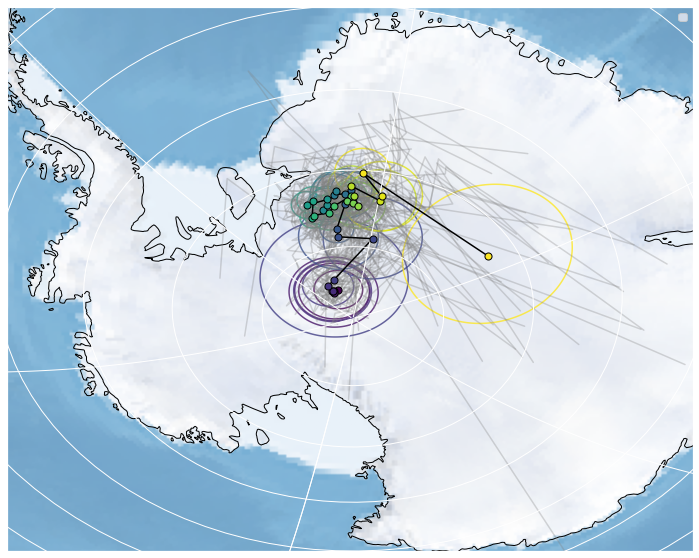

Time Step: 2 Ma, Window lenght: 19 Ma.


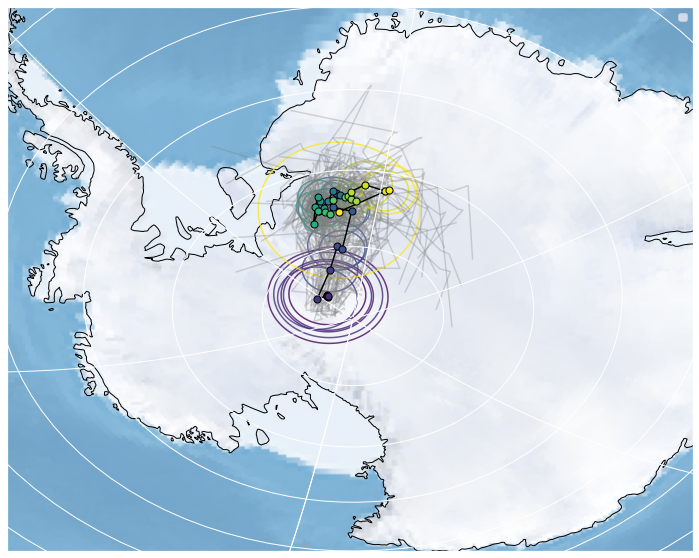

Time Step: 2 Ma, Window lenght: 21 Ma.


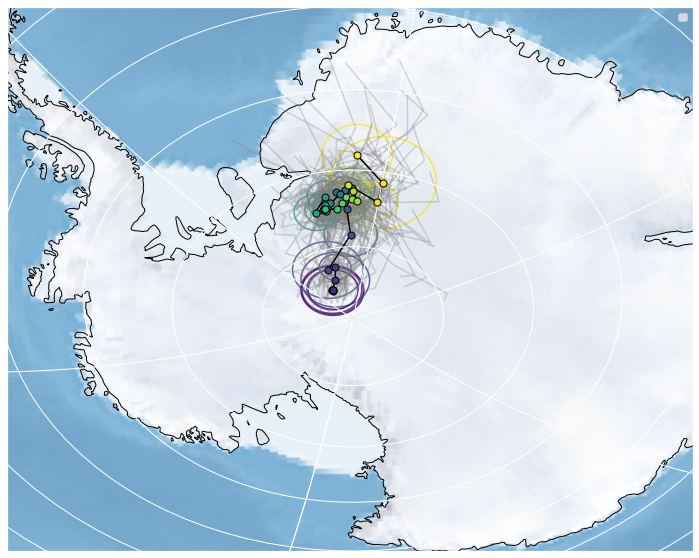

Time Step: 2 Ma, Window lenght: 23 Ma.


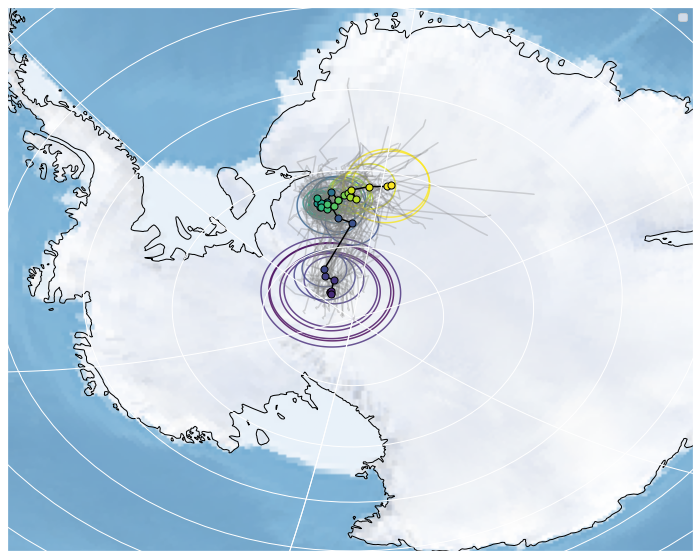

Time Step: 2 Ma, Window lenght: 25 Ma.


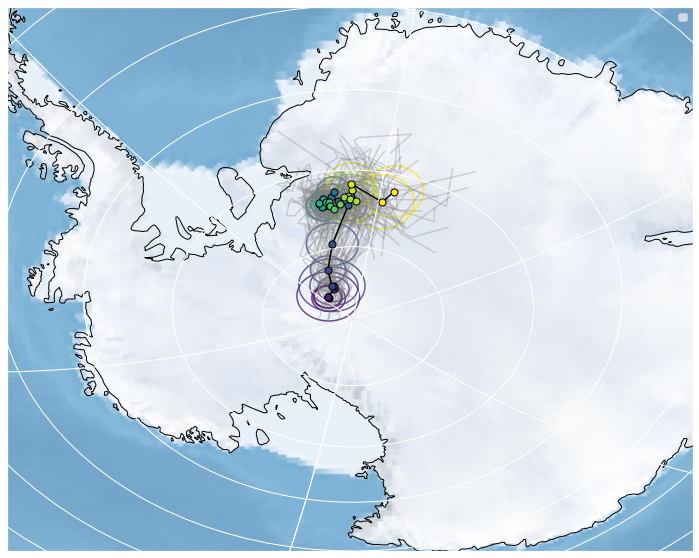

Time Step: 2 Ma, Window lenght: 27 Ma.


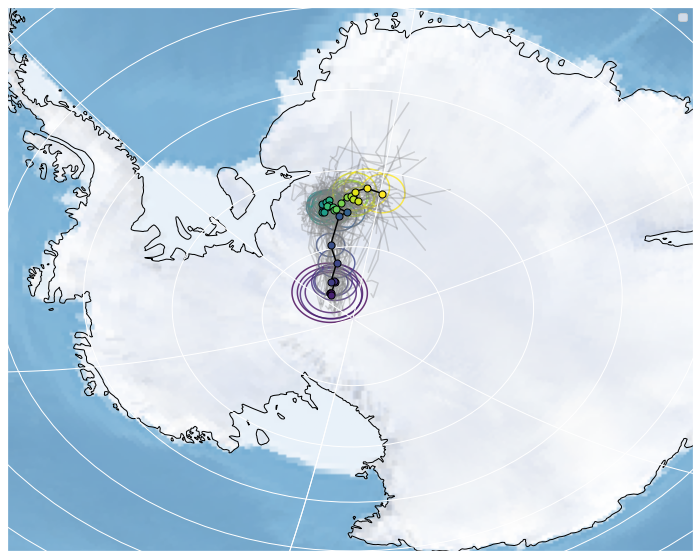

Time Step: 2 Ma, Window lenght: 29 Ma.


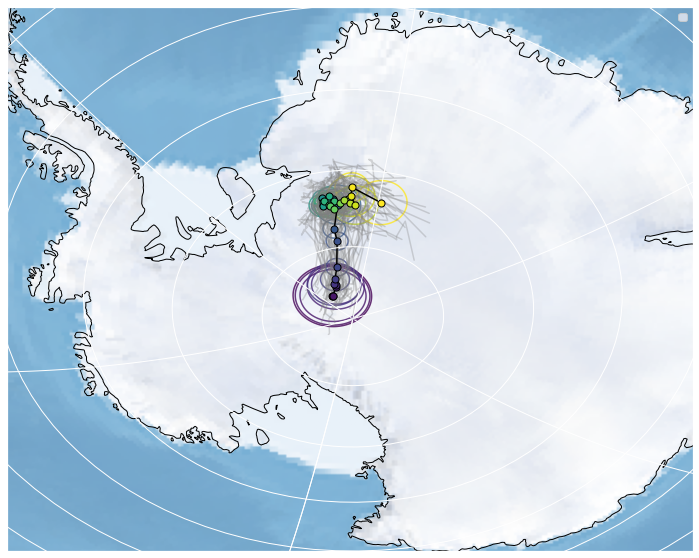

Time Step: 5 Ma, Window lenght: 5 Ma.


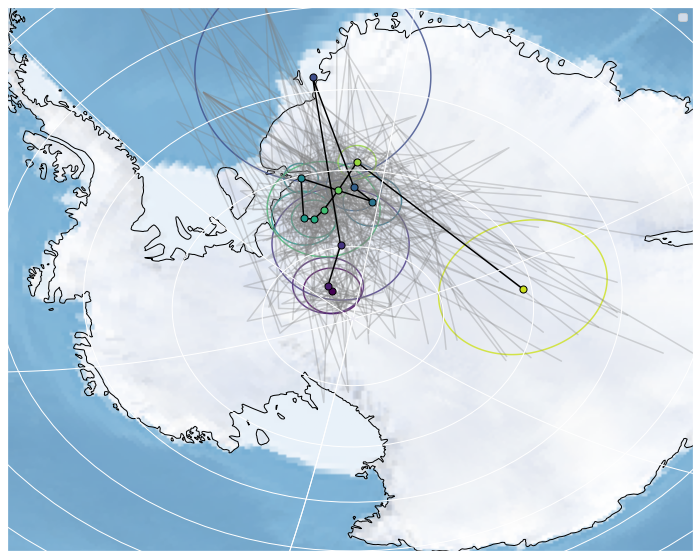

Time Step: 5 Ma, Window lenght: 7 Ma.


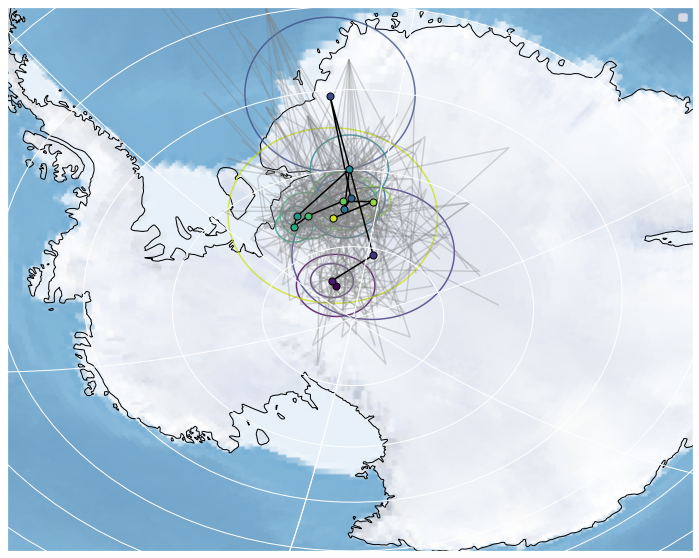

Time Step: 5 Ma, Window lenght: 9 Ma.


IllegalArgumentException: Points of LinearRing do not form a closed linestring


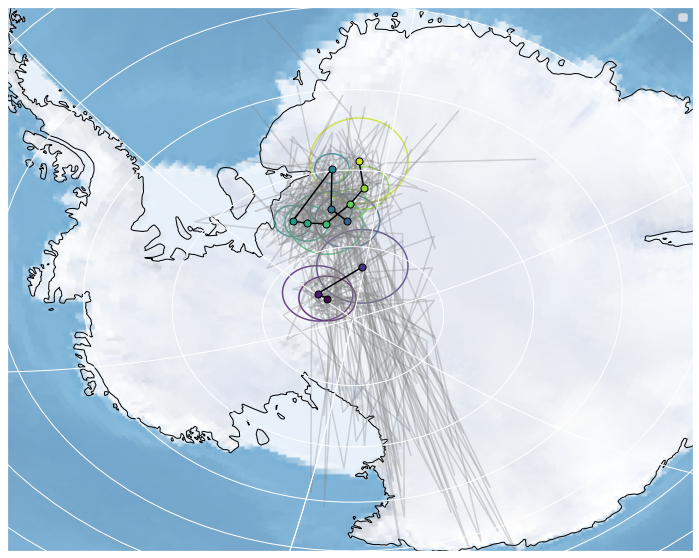

Time Step: 5 Ma, Window lenght: 11 Ma.


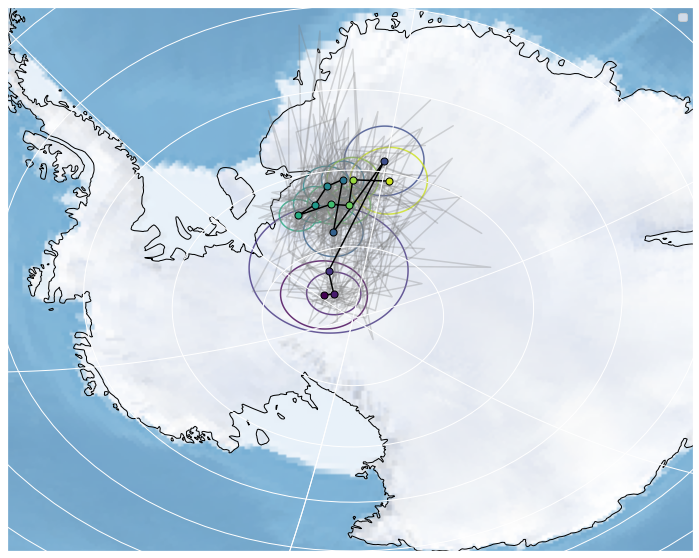

Time Step: 5 Ma, Window lenght: 13 Ma.


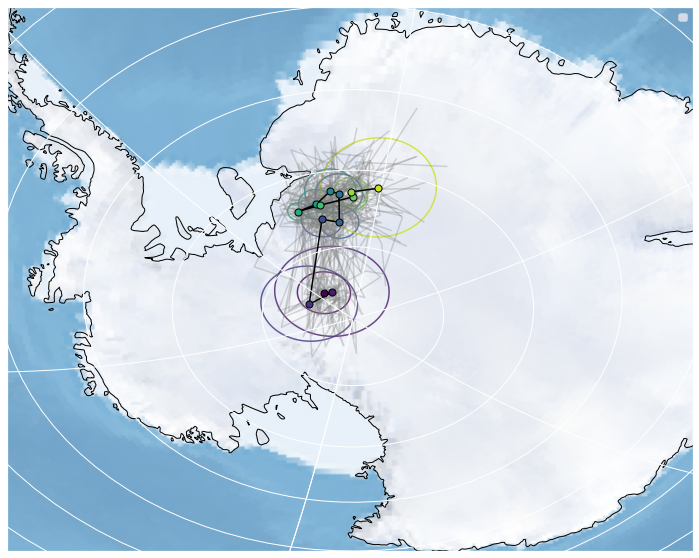

Time Step: 5 Ma, Window lenght: 15 Ma.


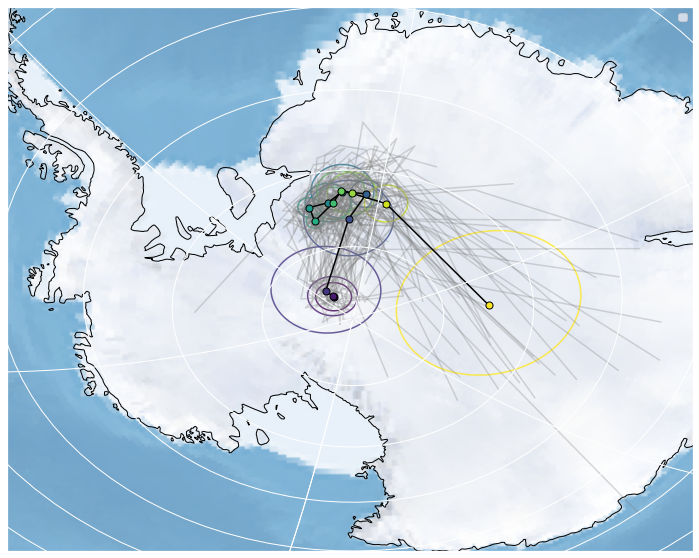

Time Step: 5 Ma, Window lenght: 17 Ma.


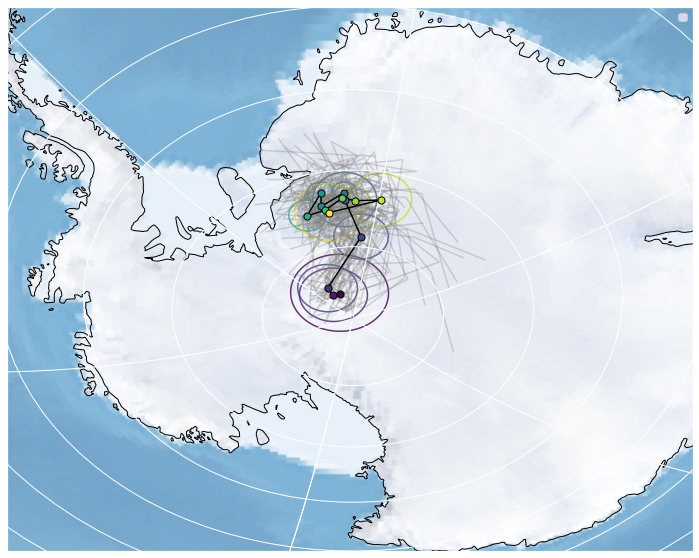

Time Step: 5 Ma, Window lenght: 19 Ma.


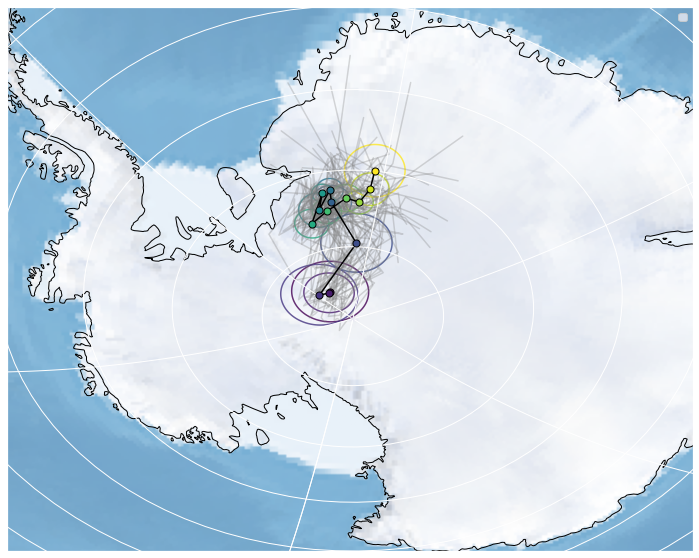

Time Step: 5 Ma, Window lenght: 21 Ma.


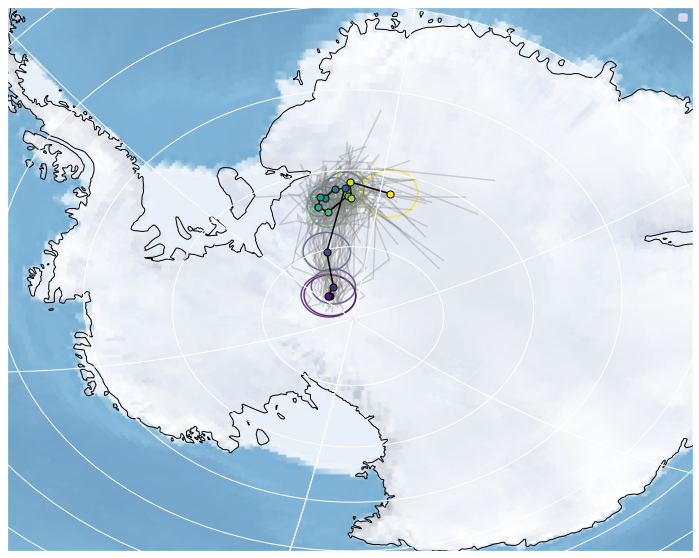

Time Step: 5 Ma, Window lenght: 23 Ma.


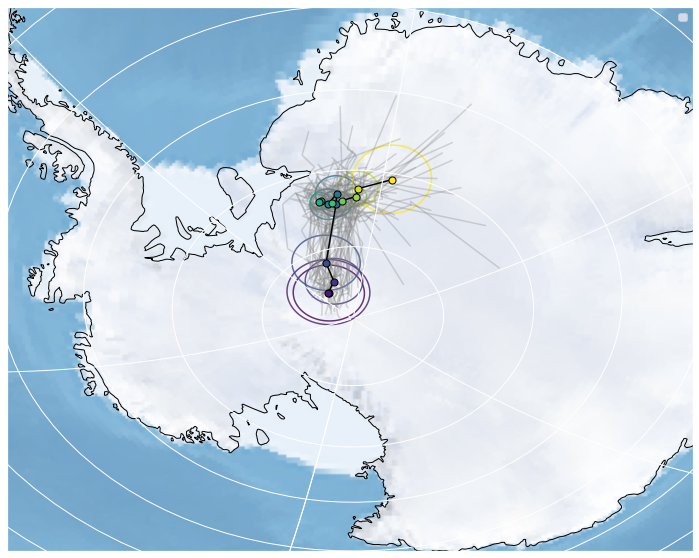

Time Step: 5 Ma, Window lenght: 25 Ma.


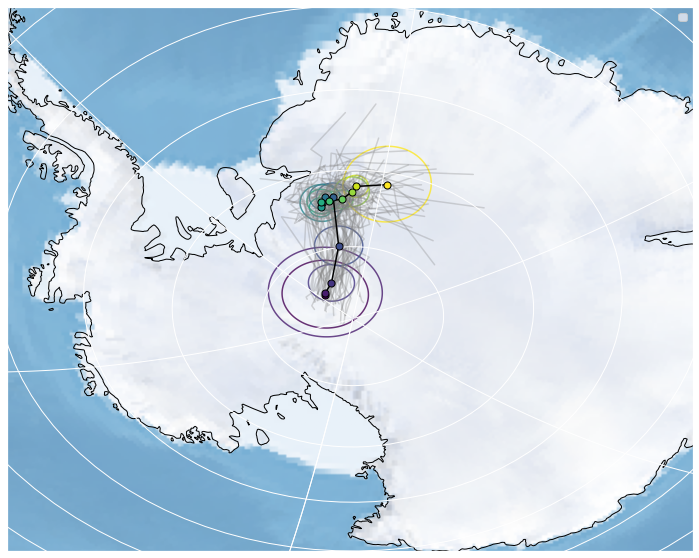

Time Step: 5 Ma, Window lenght: 27 Ma.


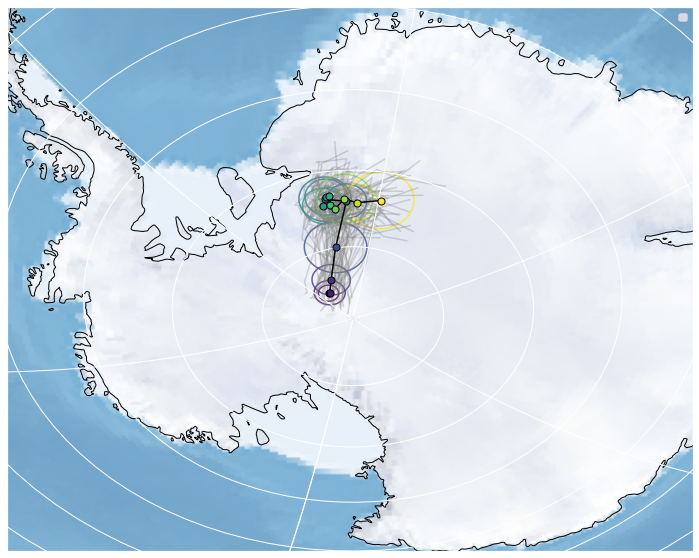

Time Step: 5 Ma, Window lenght: 29 Ma.


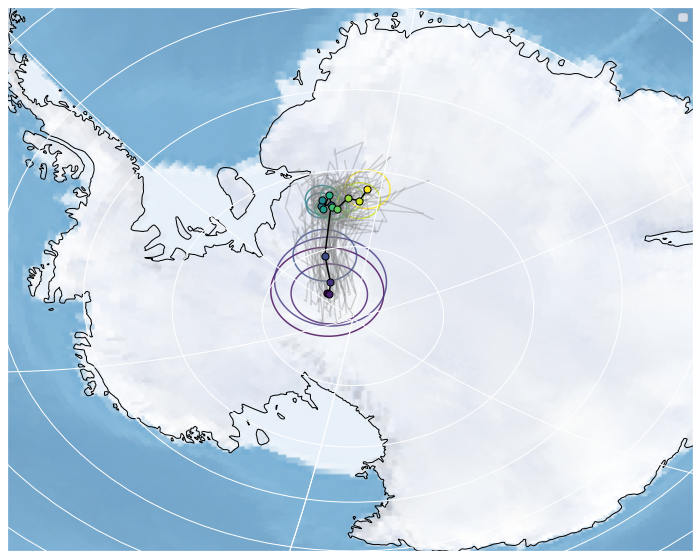

Time Step: 10 Ma, Window lenght: 5 Ma.


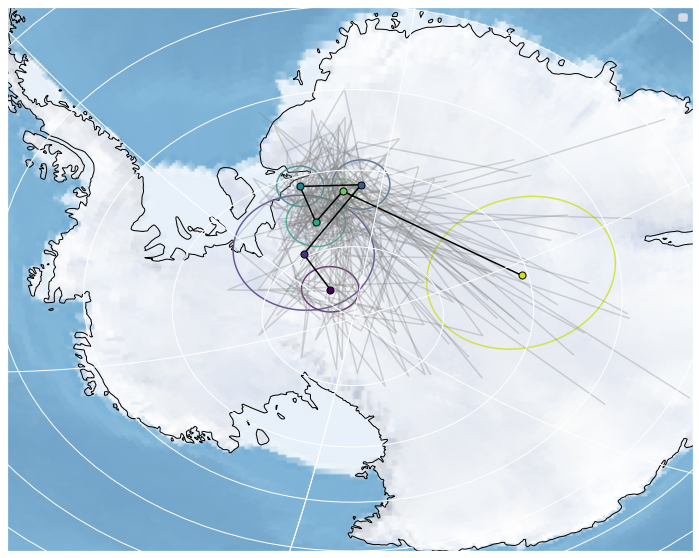

Time Step: 10 Ma, Window lenght: 7 Ma.


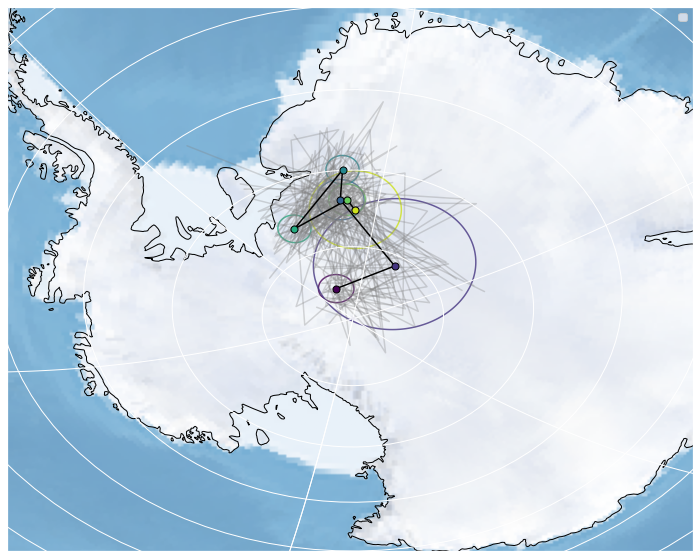

Time Step: 10 Ma, Window lenght: 9 Ma.


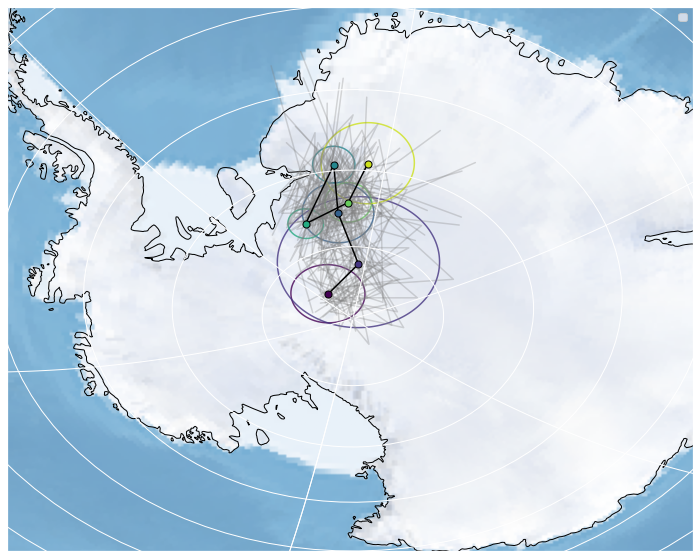

Time Step: 10 Ma, Window lenght: 11 Ma.


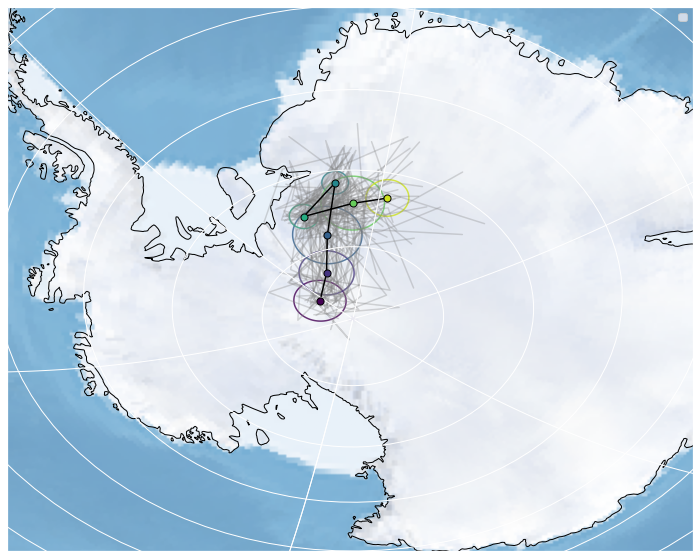

Time Step: 10 Ma, Window lenght: 13 Ma.


IllegalArgumentException: Points of LinearRing do not form a closed linestring


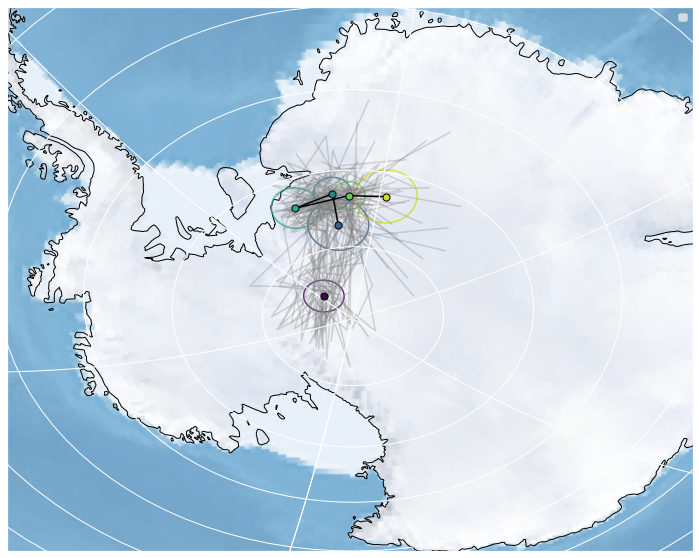

Time Step: 10 Ma, Window lenght: 15 Ma.


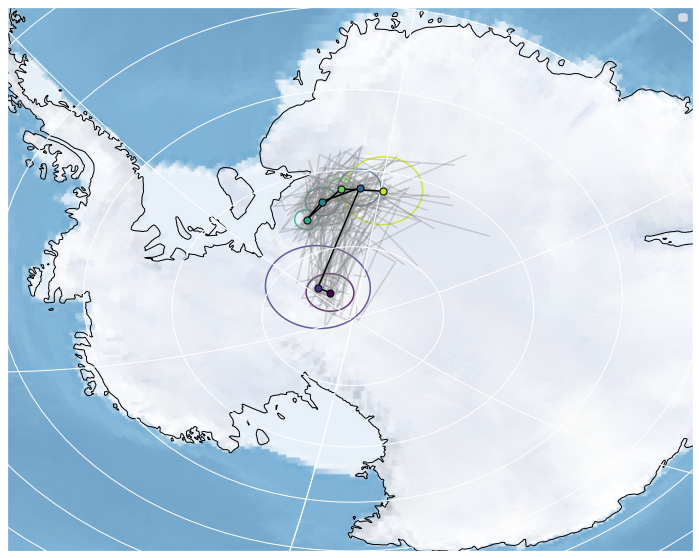

Time Step: 10 Ma, Window lenght: 17 Ma.


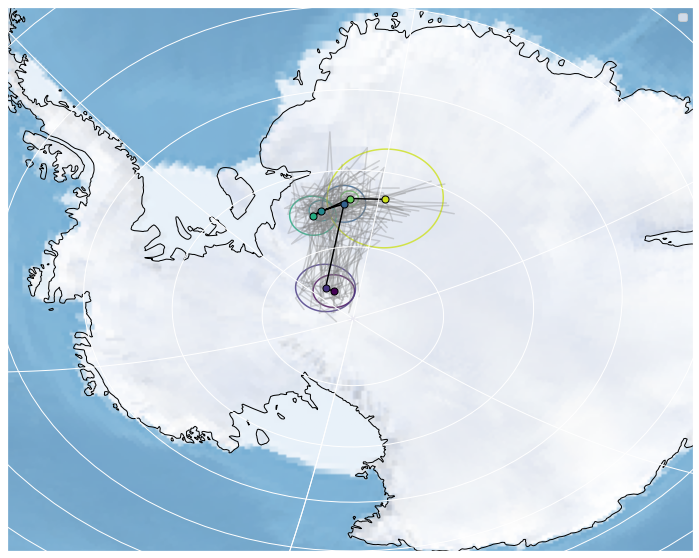

Time Step: 10 Ma, Window lenght: 19 Ma.


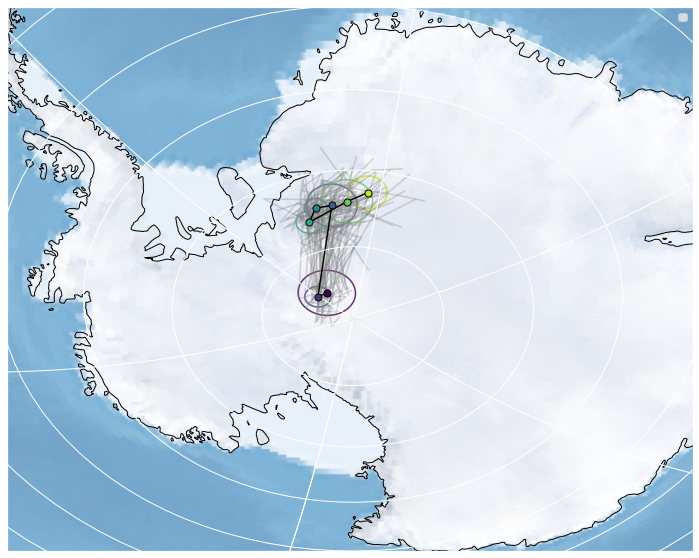

Time Step: 10 Ma, Window lenght: 21 Ma.


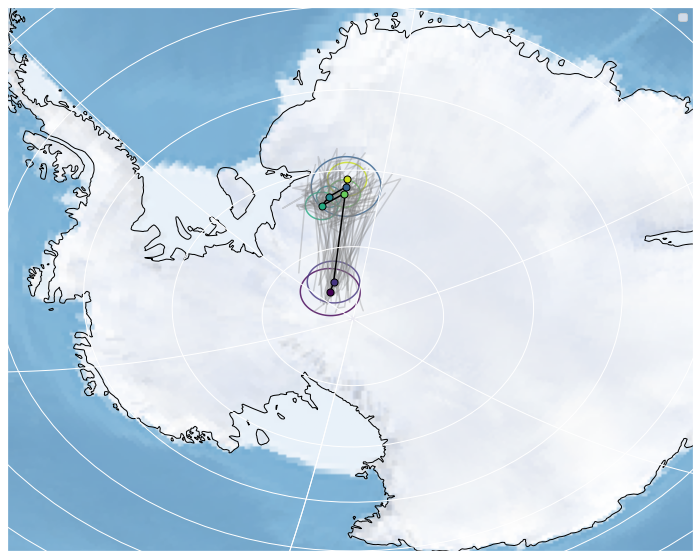

Time Step: 10 Ma, Window lenght: 23 Ma.


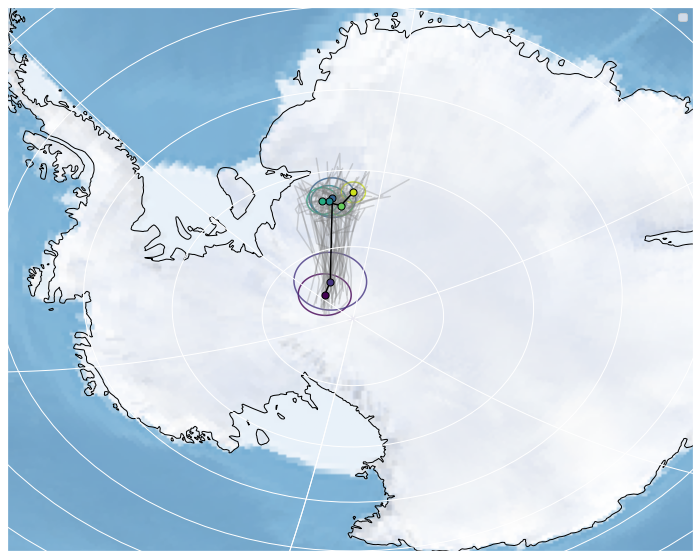

Time Step: 10 Ma, Window lenght: 25 Ma.


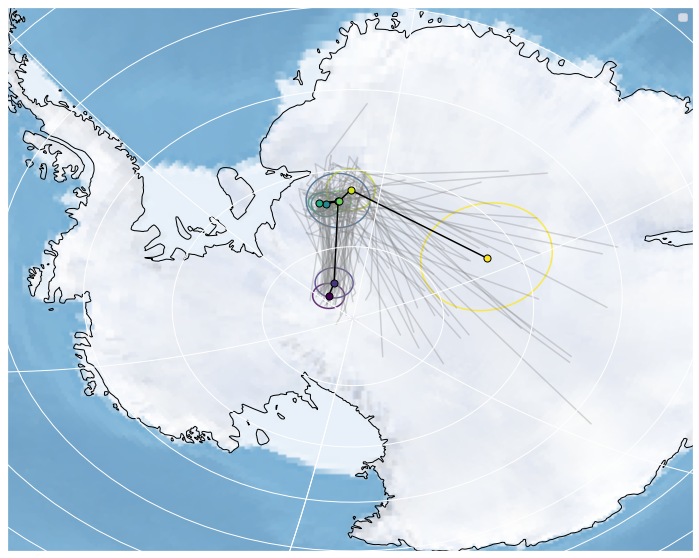

Time Step: 10 Ma, Window lenght: 27 Ma.


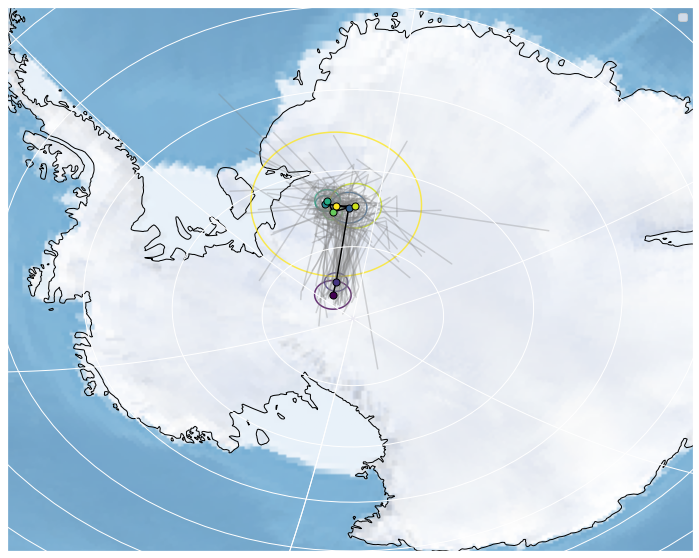

Time Step: 10 Ma, Window lenght: 29 Ma.


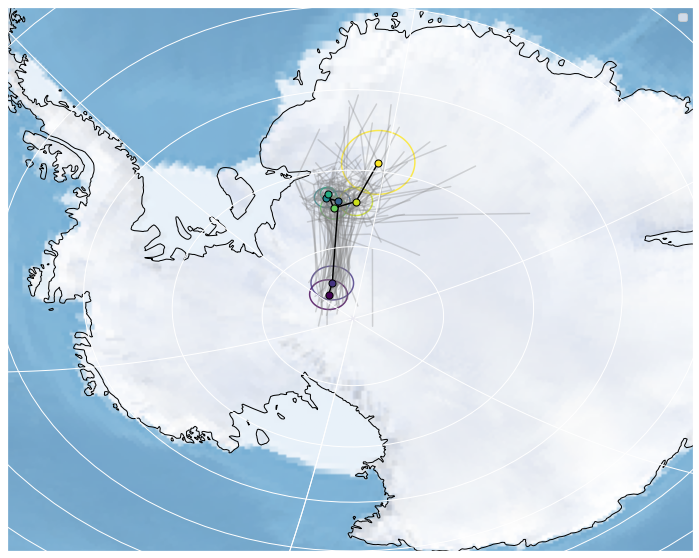

In [85]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.geodesic import Geodesic
from shapely.geometry import Polygon

extent = [-180,180,-70,-70]
proj = ccrs.Orthographic(central_longitude=-10.0, central_latitude=-50.0)

for timestep, df_timestep in df.groupby('time_step'):
    for window, df_window in df_timestep.groupby('window'):
        
        print(f"Time Step: {timestep} Ma, Window lenght: {window} Ma.")
        
        fig = plt.figure(figsize=(20,10))

        ax = plt.axes(projection=proj)  
        ax.coastlines()
        ax.stock_img()
        ax.gridlines()
        ax.set_extent(extent, crs = ccrs.PlateCarree())
        
        for i in df_window.run.unique():
            plt.plot(df_window[df_window['run']==i].plon.tolist(), df_window[df_window['run']==i].plat.tolist(),transform = ccrs.Geodetic(), color = "grey", alpha = 0.3  ) 
        plt.plot(PC(df_window,"age","plat","plon").PC()[0].tolist(), PC(df_window,"age","plat","plon").PC()[1].tolist(),transform = ccrs.Geodetic(), color = "black", alpha = 1)
        
        for i in zip(PC(df_window,"age","plat","plon").PC()[0].tolist(), PC(df_window,"age","plat","plon").PC()[1].tolist(),PC(df_window,"age","plat","plon").PC()[2].tolist(), df_window['age'].unique().transpose()):
            try:
                plot_pole_A95(i[1],i[0],i[2],i[3],0,65,ax)
            except:
                pass
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(reversed(handles), reversed(labels))
        plt.show()


In [ ]:
def running_mean_APWP_shape(data, plon_label, plat_label, age_label, window_length, time_step, max_age, min_age):
    """
    function to generate running mean APWP..
    """
    
    mean_pole_ages = np.arange(min_age, max_age + time_step, time_step)
    
    running_means = pd.DataFrame(columns=['age','N','n_studies','k','A95','csd','plon','plat', 'foliation','lineation','collinearity','coplanarity'])
    
    for age in mean_pole_ages:
        window_min = age - (window_length / 2.)
        window_max = age + (window_length / 2.)
        poles = data.loc[(data[age_label] >= window_min) & (data[age_label] <= window_max)]
        number_studies = len(poles['Study'].unique())
        mean = ipmag.fisher_mean(dec=poles[plon_label].tolist(), inc=poles[plat_label].tolist())
        
        ArrayXYZ = np.array([spherical2cartesian([i[plat_label], i[plon_label]]) for _,i in poles.iterrows()])        
        if len(ArrayXYZ) > 3:
            shapes = shape(ArrayXYZ)       
        else:
            shapes = [np.nan,np.nan,np.nan,np.nan]
        
        if mean: # this just ensures that dict isn't empty
            running_means.loc[age] = [age, mean['n'], number_studies, mean['k'],mean['alpha95'], mean['csd'], mean['dec'], mean['inc'], 
                                      shapes[0], shapes[1], shapes[2], shapes[3]]
    running_means['plon'] = running_means.apply(lambda row: row.plon - 360 if row.plon > 180 else row.plon, axis =1)
    running_means.reset_index(drop=1, inplace=True)
    
    return running_means

In [1]:
a = [GCD_cartesian(previous, current) for previous, current in zip(test['PPcartesian'].tolist(), test['PPcartesian'].tolist()[1:])].insert(0, 0)

NameError: name 'test' is not defined

In [5]:
from vgptools.auxiliar import GCD_cartesian

In [ ]:
running_mean_APWP_shape(sample, 'vgp_lon_SH', 'vgp_lat_SH', 'mean_age', window, step, max_age, min_age)

In [ ]:
a = [GCD_cartesian(previous, current) for previous, current in zip(test['PPcartesian'].tolist(), test['PPcartesian'].tolist()[1:])].insert(0, 0)

In [31]:
df_test = df_ensemble[0:28].copy()
# df_test = df_ensemble[]

In [17]:
def running_mean_APWP_shape(data, plon_label, plat_label, age_label, window_length, time_step, max_age, min_age):
    """
    function to generate running mean APWP..
    """
    
    mean_pole_ages = np.arange(min_age, max_age + time_step, time_step)
    
    running_means = pd.DataFrame(columns=['age','N','n_studies','k','A95','csd','plon','plat', 'foliation','lineation','collinearity','coplanarity'])
    
    for age in mean_pole_ages:
        window_min = age - (window_length / 2.)
        window_max = age + (window_length / 2.)
        poles = data.loc[(data[age_label] >= window_min) & (data[age_label] <= window_max)]
        number_studies = len(poles['Study'].unique())
        mean = ipmag.fisher_mean(dec=poles[plon_label].tolist(), inc=poles[plat_label].tolist())
        
        ArrayXYZ = np.array([spherical2cartesian([i[plat_label], i[plon_label]]) for _,i in poles.iterrows()])        
        if len(ArrayXYZ) > 3:
            shapes = shape(ArrayXYZ)       
        else:
            shapes = [np.nan,np.nan,np.nan,np.nan]
        
        if mean: # this just ensures that dict isn't empty
            running_means.loc[age] = [age, mean['n'], number_studies, mean['k'],mean['alpha95'], mean['csd'], mean['dec'], mean['inc'], 
                                      shapes[0], shapes[1], shapes[2], shapes[3]]
    # Set longitudes in [-180, 180]
    running_means['plon'] = running_means.apply(lambda row: row.plon - 360 if row.plon > 180 else row.plon, axis =1)   
    
    # The following block calculates rate of polar wander (degrees per million years) 
    running_means['PPcartesian'] = running_means.apply(lambda row: spherical2cartesian([np.radians(row['plat']),np.radians(row['plon'])]), axis = 1)
    running_means['PP_prev'] = running_means['PPcartesian'].shift(periods = 1)
    running_means['PP_next'] =  running_means['PPcartesian'].shift(periods = -1)
    running_means['GCD'] = running_means.apply(lambda row: np.degrees(GCD_cartesian(row['PP_prev'], row['PPcartesian'])), axis = 1)
    running_means['APW_rate'] = running_means['GCD']/running_means['age'].diff()
    running_means['angle'] = running_means.apply(lambda row: get_angle(row['PP_prev'], row['PPcartesian'], row['PP_next']), axis = 1)
    
#     list_gcd = [GCD_cartesian(prev, curr) for prev, curr in zip(running_means['PPcartesian'].tolist(), running_means['PPcartesian'].tolist()[1:])]
#     running_means['GCD'] = np.insert(np.degrees(list_gcd),0,0) # insert a zero in the first row
#     running_means['APW_rate'] = np.where(running_means['age'] != 0, running_means['GCD']/running_means['age'].diff(), 0) #set as zero the velocity if age==0
    
    # Calculate a 'kink' angle for each position of the path
    
    
    
    
    running_means = running_means.drop(['PPcartesian', 'PP_prev', 'PP_next'], axis=1)      
    running_means.reset_index(drop=1, inplace=True)
    
    return running_means


In [18]:
RM = running_mean_APWP_shape(df_filtered_vgps, 'vgp_lon_SH', 'vgp_lat_SH', 'mean_age', 20, 10, 60, 0)
RM

,age,N,n_studies,k,A95,csd,plon,plat,foliation,lineation,collinearity,coplanarity,GCD,APW_rate,angle
0,0.0,305.0,15.0,23.294563,1.704883,16.782542,-42.916770,-87.945102,0.172195,0.689179,4.002320,0.861373,NaN,NaN,NaN
1,10.0,330.0,16.0,21.201852,1.721511,17.591307,-32.699012,-87.482422,0.157223,0.679840,4.324037,0.837064,0.614882,0.061488,164.942782
2,20.0,207.0,9.0,10.117603,3.239569,25.465148,-18.040466,-82.115848,0.166396,0.452697,2.720591,0.619093,5.485406,0.548541,61.504976
3,30.0,359.0,7.0,12.400810,2.196629,23.001703,-23.655338,-82.377411,0.014819,0.626164,42.254224,0.640983,0.801003,0.080100,85.629971
4,40.0,304.0,9.0,16.589316,2.042163,19.887069,-23.063655,-82.580048,0.129169,0.608712,4.712527,0.737881,0.216930,0.021693,87.487473
5,50.0,300.0,10.0,15.595424,2.124634,20.510981,-11.679274,-81.701340,0.196373,0.396824,2.020770,0.593197,1.783301,0.178330,159.571225
6,60.0,174.0,4.0,14.853001,2.868671,21.017348,-8.153409,-80.873175,0.183792,0.367465,1.999352,0.551256,0.985086,0.098509,NaN


In [13]:
RM

,age,N,n_studies,k,A95,csd,plon,plat,foliation,lineation,collinearity,coplanarity,PPcartesian,GCD,APW_rate,PP_prev,PP_next,angle,GCD_
0,0.0,305.0,15.0,23.294563,1.704883,16.782542,-42.916770,-87.945102,0.172195,0.689179,4.002320,0.861373,"[0.026259683195198835, -0.024416330316297422, ...",0.000000,0.000000,NaN,"[0.03696452111440212, -0.023729900288161593, -...",NaN,NaN
1,10.0,330.0,16.0,21.201852,1.721511,17.591307,-32.699012,-87.482422,0.157223,0.679840,4.324037,0.837064,"[0.03696452111440212, -0.023729900288161593, -...",0.614882,0.061488,"[0.026259683195198835, -0.024416330316297422, ...","[0.13042698795906915, -0.04248016219703352, -0...",164.942782,0.614882
2,20.0,207.0,9.0,10.117603,3.239569,25.465148,-18.040466,-82.115848,0.166396,0.452697,2.720591,0.619093,"[0.13042698795906915, -0.04248016219703352, -0...",5.485406,0.548541,"[0.03696452111440212, -0.023729900288161593, -...","[0.12150157551575719, -0.05322254066158221, -0...",61.504976,5.485406
3,30.0,359.0,7.0,12.400810,2.196629,23.001703,-23.655338,-82.377411,0.014819,0.626164,42.254224,0.640983,"[0.12150157551575719, -0.05322254066158221, -0...",0.801003,0.080100,"[0.13042698795906915, -0.04248016219703352, -0...","[0.1188187100210522, -0.050591415199229946, -0...",85.629971,0.801003
4,40.0,304.0,9.0,16.589316,2.042163,19.887069,-23.063655,-82.580048,0.129169,0.608712,4.712527,0.737881,"[0.1188187100210522, -0.050591415199229946, -0...",0.216930,0.021693,"[0.12150157551575719, -0.05322254066158221, -0...","[0.14134479591146448, -0.029217782047498576, -...",87.487473,0.216930
5,50.0,300.0,10.0,15.595424,2.124634,20.510981,-11.679274,-81.701340,0.196373,0.396824,2.020770,0.593197,"[0.14134479591146448, -0.029217782047498576, -...",1.783301,0.178330,"[0.1188187100210522, -0.050591415199229946, -0...","[0.15701699344500297, -0.02249617685084299, -0...",159.571225,1.783301
6,60.0,174.0,4.0,14.853001,2.868671,21.017348,-8.153409,-80.873175,0.183792,0.367465,1.999352,0.551256,"[0.15701699344500297, -0.02249617685084299, -0...",0.985086,0.098509,"[0.14134479591146448, -0.029217782047498576, -...",NaN,NaN,0.985086


In [10]:
RM['PP_prev'] = RM['PPcartesian'].shift(periods = 1)
RM['PP_next'] =  RM['PPcartesian'].shift(periods = -1)

RM['GCD_'] = RM.apply(lambda row: np.degrees(GCD_cartesian(row['PP_prev'], row['PPcartesian'])), axis = 1)
RM['angle'] = RM.apply(lambda row: get_angle(row['PP_prev'], row['PPcartesian'], row['PP_next']), axis = 1)


In [11]:
RM

,age,N,n_studies,k,A95,csd,plon,plat,foliation,lineation,collinearity,coplanarity,PPcartesian,GCD,APW_rate,PP_prev,PP_next,angle,GCD_
0,0.0,305.0,15.0,23.294563,1.704883,16.782542,-42.916770,-87.945102,0.172195,0.689179,4.002320,0.861373,"[0.026259683195198835, -0.024416330316297422, ...",0.000000,0.000000,NaN,"[0.03696452111440212, -0.023729900288161593, -...",NaN,NaN
1,10.0,330.0,16.0,21.201852,1.721511,17.591307,-32.699012,-87.482422,0.157223,0.679840,4.324037,0.837064,"[0.03696452111440212, -0.023729900288161593, -...",0.614882,0.061488,"[0.026259683195198835, -0.024416330316297422, ...","[0.13042698795906915, -0.04248016219703352, -0...",164.942782,0.614882
2,20.0,207.0,9.0,10.117603,3.239569,25.465148,-18.040466,-82.115848,0.166396,0.452697,2.720591,0.619093,"[0.13042698795906915, -0.04248016219703352, -0...",5.485406,0.548541,"[0.03696452111440212, -0.023729900288161593, -...","[0.12150157551575719, -0.05322254066158221, -0...",61.504976,5.485406
3,30.0,359.0,7.0,12.400810,2.196629,23.001703,-23.655338,-82.377411,0.014819,0.626164,42.254224,0.640983,"[0.12150157551575719, -0.05322254066158221, -0...",0.801003,0.080100,"[0.13042698795906915, -0.04248016219703352, -0...","[0.1188187100210522, -0.050591415199229946, -0...",85.629971,0.801003
4,40.0,304.0,9.0,16.589316,2.042163,19.887069,-23.063655,-82.580048,0.129169,0.608712,4.712527,0.737881,"[0.1188187100210522, -0.050591415199229946, -0...",0.216930,0.021693,"[0.12150157551575719, -0.05322254066158221, -0...","[0.14134479591146448, -0.029217782047498576, -...",87.487473,0.216930
5,50.0,300.0,10.0,15.595424,2.124634,20.510981,-11.679274,-81.701340,0.196373,0.396824,2.020770,0.593197,"[0.14134479591146448, -0.029217782047498576, -...",1.783301,0.178330,"[0.1188187100210522, -0.050591415199229946, -0...","[0.15701699344500297, -0.02249617685084299, -0...",159.571225,1.783301
6,60.0,174.0,4.0,14.853001,2.868671,21.017348,-8.153409,-80.873175,0.183792,0.367465,1.999352,0.551256,"[0.15701699344500297, -0.02249617685084299, -0...",0.985086,0.098509,"[0.14134479591146448, -0.029217782047498576, -...",NaN,NaN,0.985086


In [7]:
get_angle(np.nan, RM['PPcartesian'][0], RM['PPcartesian'][1])

nan

In [37]:
cartesian1 = np.nan
cartesian2=[0,0,0]
dot = np.dot(cartesian1, cartesian2)
if np.isnan(dot).any(): return np.nan
if abs(dot) > 1: dot = round(dot)

SyntaxError: 'return' outside function (Temp/ipykernel_162888/2743178084.py, line 4)

In [25]:
dot = np.dot(cartesian1, cartesian2)

In [26]:
dot

array([nan, nan, nan])

In [31]:
if abs(dot) > 1: dot = round(dot)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [34]:
np.isnan(dot).any()

True

In [35]:
cartesian1 = [0,0,1]
cartesian2=[0,0,0]
dot = np.dot(cartesian1, cartesian2)
dot

0

In [64]:
from pyscopus import Scopus

In [65]:
key = 'ff1fa914ed3c85906e2f19e70e1f70bd'
scopus = Scopus(key)
search_df = scopus.search("KEY(interdisciplinary collaboration)", count=20)

In [67]:
author_result_df = scopus.search_author("AUTHLASTNAME(Zhao) and AUTHFIRST(Kang) and AFFIL(Iowa)")
author_result_df

,author_id,name,document_count,affiliation,affiliation_id
0,36635367700,Kang Zhao,67,University of Iowa,60024324


In [68]:
pub_citations_df = scopus.retrieve_citation(scopus_id_array=['84905286162', '0141607824'],
                                            year_range=[2010, 2014])

KeyError: 'abstract-citations-response'